# Packages

In [1]:
import numpy as np
import pandas as pd
import plotly.graph_objs as go
import plotly.offline as py
import prophet
from prophet.plot import plot_plotly, add_changepoints_to_plot
import streamlit as st
py.init_notebook_mode()
import yfinance as yfinance
from keras.models import Sequential
from keras.layers import LSTM, Dropout, Dense, Activation
import datetime

# Data collection and process

In [2]:
import pandas_datareader as web
ticker = pd.read_csv('./dataset/nasdaq_techundtelelar77.csv')['Symbol']
df = pd.DataFrame
#The end date will set automatically to current date.
df = web.DataReader(ticker,'yahoo', start= '2017-06-01',end ='2022-07-01')['Adj Close']
             
                                           
        
        
df

Symbols,AAPL,ADBE,ADI,ADSK,AMAT,AMD,ANSS,APP,ASML,AVGO,...,TXN,VOD,VRSN,WBD,WDAY,WDC,ZBRA,ZI,ZM,ZS
Date,,,,,,,,,,,,,,,,,,,,,
2017-06-01,36.252579,141.380005,74.143349,113.029999,43.195930,10.930000,127.860001,NaN,127.719078,194.508774,...,70.991257,21.488810,92.279999,26.740000,101.500000,82.573921,108.139999,NaN,NaN,NaN
2017-06-02,36.789814,143.479996,72.970909,112.910004,43.947166,10.900000,129.490005,NaN,128.568573,211.041885,...,71.113213,21.567392,92.550003,26.490000,104.410004,82.510818,107.750000,NaN,NaN,NaN
2017-06-05,36.430080,143.589996,71.022835,110.879997,43.872028,11.240000,129.539993,NaN,127.098694,209.118271,...,71.339706,21.560247,92.519997,26.209999,102.870003,80.617531,105.900002,NaN,NaN,NaN
2017-06-06,36.553146,143.029999,72.240372,111.449997,43.731186,12.030000,128.399994,NaN,126.583275,210.486404,...,71.627220,21.524527,92.070000,26.160000,102.660004,81.086365,105.239998,NaN,NaN,NaN
2017-06-07,36.770870,143.619995,73.310608,111.169998,44.379112,12.380000,128.339996,NaN,127.890930,210.834625,...,72.210884,21.534176,92.260002,26.410000,102.500000,81.077347,106.570000,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-06-27,141.660004,381.070007,150.589996,185.869995,97.610001,86.160004,250.800003,38.340000,508.040009,505.709991,...,154.601715,15.740000,168.850006,14.080000,148.050003,47.580002,309.829987,36.450001,119.820000,164.229996
2022-06-28,137.440002,365.630005,148.490005,176.809998,95.019997,80.779999,240.139999,36.250000,490.410004,498.450012,...,153.151276,15.690000,164.259995,13.660000,144.250000,46.740002,302.209991,34.930000,113.129997,154.919998
2022-06-29,139.229996,368.500000,147.270004,176.850006,91.940002,77.989998,241.460007,35.549999,484.619995,490.410004,...,151.780304,15.440000,166.259995,13.170000,146.309998,45.400002,298.329987,34.189999,111.870003,154.949997


In [6]:
figure = pd.read_csv('./dataset/nasdaqtechend.csv')
figure.head()

import plotly.express as px
#df = px.data.stocks()
fig = px.line(figure, x="Date", y=figure.columns,
             hover_data={"Date": "|%B %d, %Y"},
              title='custom tick labels')
fig.update_xaxes(
    dtick="M1",
    tickformat="%b\n%Y")
fig.show()

In [7]:
#df.to_csv('nasdaqtechend.csv')

In [3]:
#df = pd.read_csv('nasdaqtechend.csv')
from sua import EfficientFrontier
from sua import risk_models
from sua import expected_returns

# Calculate the expected annual returns and the annulized sample covariance matrix of the daily asset  returns

mu = expected_returns.mean_historical_return(df)
S = risk_models.sample_cov(df)



In [4]:

ef = EfficientFrontier(mu, S)
#ef.add_objective(objective_functions.L2_reg, gamma=2)
weights= ef.max_sharpe()
#weights = ef.nonconvex_objective(
       #objective_functions.sharpe_ratio,
       #objective_args=(ef.expected_returns, ef.cov_matrix),
       #weights_sum_to_one=True,

    #)
cleaned_weights = ef.clean_weights()
print(cleaned_weights)
ef.portfolio_performance(verbose=True)

OrderedDict([('AAPL', 0.00692), ('ADBE', 0.0), ('ADI', 0.0), ('ADSK', 0.0), ('AMAT', 0.0), ('AMD', 0.02549), ('ANSS', 0.0), ('APP', 0.0), ('ASML', 0.0), ('AVGO', 0.0), ('AZPN', 0.0), ('BIDU', 0.0), ('BILI', 0.0), ('CDNS', 0.0), ('CDW', 0.0), ('CHKP', 0.0), ('COIN', 0.0), ('CRWD', 0.0), ('CSCO', 0.0), ('CTSH', 0.0), ('CTXS', 0.0), ('DDOG', 0.0), ('DOCU', 0.0), ('DOX', 0.0), ('ENTG', 0.0), ('ERIC', 0.0), ('FTNT', 0.42549), ('GOOG', 0.0), ('GOOGL', 0.0), ('INTC', 0.0), ('INTU', 0.0), ('JKHY', 0.0), ('KLAC', 0.0), ('LBTYA', 0.0), ('LBTYB', 0.0), ('LBTYK', 0.0), ('LRCX', 0.0), ('MCHP', 0.0), ('MDB', 0.02404), ('META', 0.0), ('MPWR', 0.0), ('MRVL', 0.0), ('MSFT', 0.23266), ('MTCH', 0.0), ('MU', 0.0), ('NICE', 0.0), ('NLOK', 0.0), ('NTAP', 0.0), ('NVDA', 0.0), ('NXPI', 0.0), ('OKTA', 0.0), ('ON', 0.0), ('PANW', 0.0), ('PTC', 0.0), ('QCOM', 0.0), ('ROKU', 0.0), ('SEDG', 0.28541), ('SNPS', 0.0), ('SPLK', 0.0), ('SSNC', 0.0), ('STX', 0.0), ('SWKS', 0.0), ('TEAM', 0.0), ('TMUS', 0.0), ('TTD', 0.0

(0.5047404492329117, 0.3580154254128805, 1.3539652618986622)

In [5]:
from pypfopt.discrete_allocation import DiscreteAllocation, get_latest_prices

portfolio_val = 15000
latest_prices = get_latest_prices(df)
weights = cleaned_weights
da = DiscreteAllocation(weights, latest_prices, total_portfolio_value = portfolio_val)
allocation, leftover = da.lp_portfolio(reinvest=True ,verbose = True)
print('Discrete allocation:', allocation)
print('Funds remaining: $', leftover)

Funds remaining: 336.60
AAPL: allocated 0.009, desired 0.007
ADBE: allocated 0.000, desired 0.000
ADI: allocated 0.000, desired 0.000
ADSK: allocated 0.000, desired 0.000
AMAT: allocated 0.000, desired 0.000
AMD: allocated 0.025, desired 0.025
ANSS: allocated 0.000, desired 0.000
APP: allocated 0.000, desired 0.000
ASML: allocated 0.000, desired 0.000
AVGO: allocated 0.000, desired 0.000
AZPN: allocated 0.000, desired 0.000
BIDU: allocated 0.000, desired 0.000
BILI: allocated 0.000, desired 0.000
CDNS: allocated 0.000, desired 0.000
CDW: allocated 0.000, desired 0.000
CHKP: allocated 0.000, desired 0.000
COIN: allocated 0.000, desired 0.000
CRWD: allocated 0.000, desired 0.000
CSCO: allocated 0.000, desired 0.000
CTSH: allocated 0.000, desired 0.000
CTXS: allocated 0.000, desired 0.000
DDOG: allocated 0.000, desired 0.000
DOCU: allocated 0.000, desired 0.000
DOX: allocated 0.000, desired 0.000
ENTG: allocated 0.000, desired 0.000
ERIC: allocated 0.000, desired 0.000
FTNT: allocated 0.4

Start date: 2017-06-01
End date: 2022-07-01


,Backtest
,
Annual return,56.72%
Cumulative return,879.62%
Annual volatility,35.76 %
Winning day ratio,57.34%
Sharpe ratio,1.44
Calmar ratio,1.59
Information ratio,0.01
Stability,0.98
Max Drawdown,-35.72 %


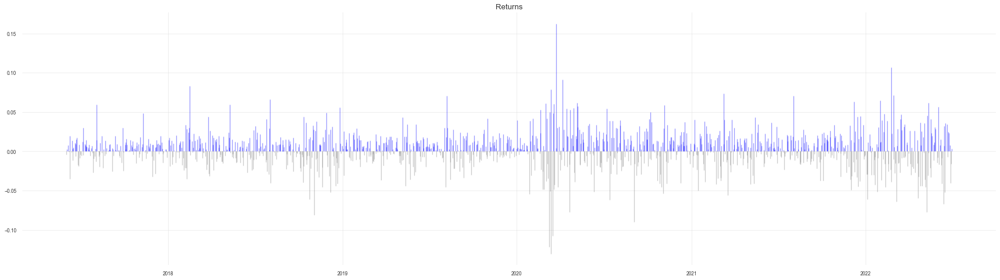

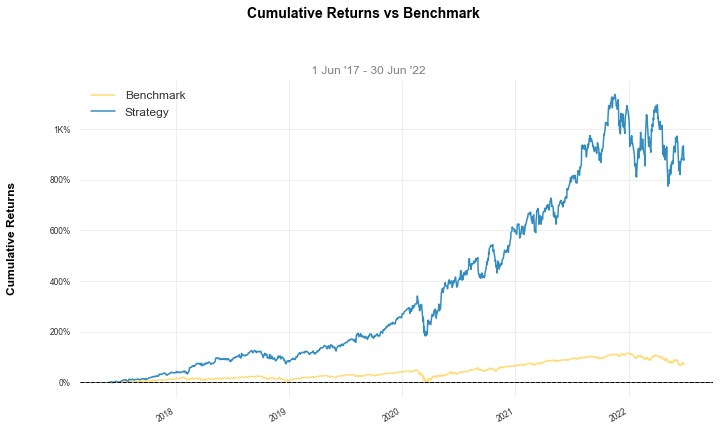

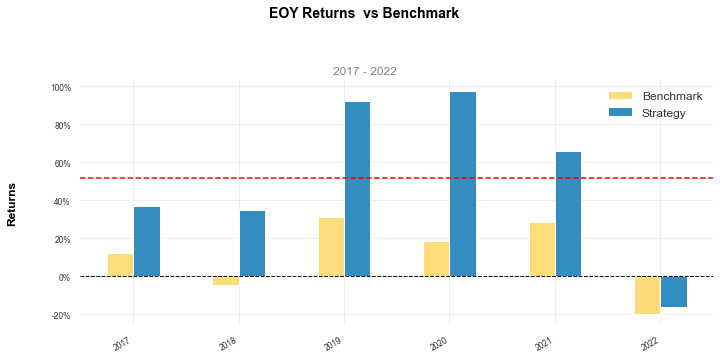

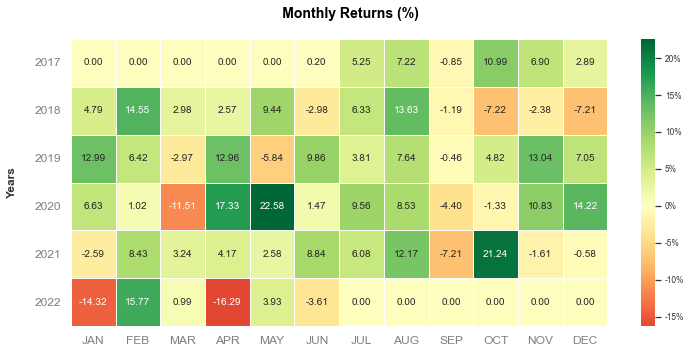

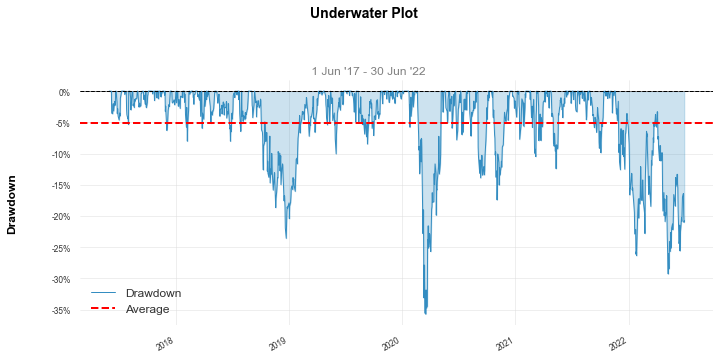

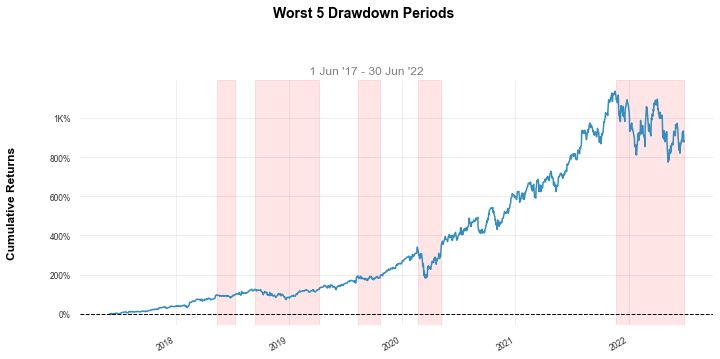

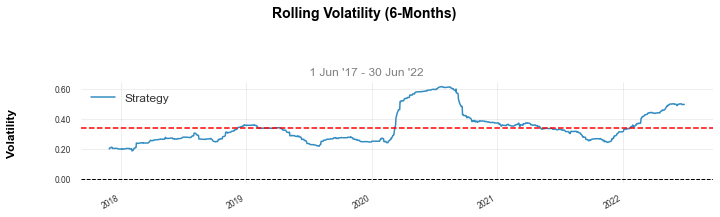

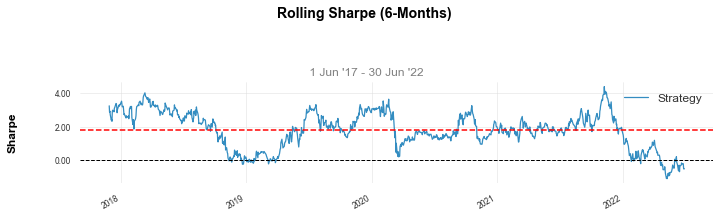

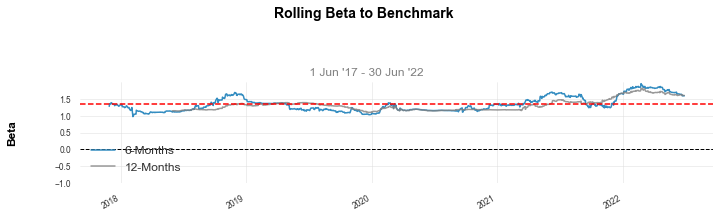

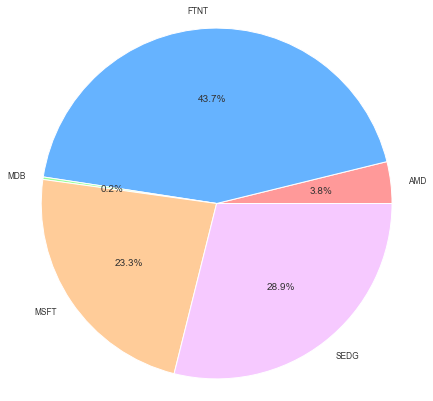

(None, None, None, None, None, None, None, None, None)

In [6]:
#!pip install sua
from sua import sua,get_report, Start

portfolio = Start(
    start_date = "2017-06-01",
    end_date= "2022-07-01",
    portfolio= [ "AAPL", "AMD","FTNT","MDB", "MSFT", "SEDG"],
    optimizer = "EF",
    #rebalance = "1y",  # rebalance every year
    risk_manager = {"Stop Loss" : -0.2} # Stop the investment when the drawdown becomes superior to -20%
)
#portfolio=Start.reshape(6,5)

sua(portfolio) #For showing in JupyterNotebook
#get_report(portfolio) #if you want to print wirh pdf form, plz use this.

In [7]:
from sua import prediction
  
prediction(
      portfolio=["AAPL", "AMD","FTNT","MDB", "MSFT", "SEDG"], #stocks you want to predict
      start_date = "2017-06-01",#date from which it will take data to predict
      end_date= "2022-07-01",
      #weights = [0.3, 0.2, 0.3, 0.2,0.2], #allocate 30% to TSLA and 20% to AAPL...(equal weighting  by default)
      prediction_days=30 #number of days you want to predict
)
  

Evaluating the models for AAPL...
Models evaluated!
Making the predictions for AAPL...
Predictions generated!
Evaluating the models for AMD...
Models evaluated!
Making the predictions for AMD...
Predictions generated!
Evaluating the models for FTNT...
Models evaluated!
Making the predictions for FTNT...
Predictions generated!
Evaluating the models for MDB...
Models evaluated!
Making the predictions for MDB...
Predictions generated!
Evaluating the models for MSFT...
Models evaluated!
Making the predictions for MSFT...
Predictions generated!
Evaluating the models for SEDG...
Models evaluated!
Making the predictions for SEDG...
Predictions generated!


Assets MAPE (accuracy score)
      Exponential smoothing    Prophet  Auto-ARIMA   Theta(2)      ARIMA        FFT  FourTheta  NaiveDrift  NaiveMean  NaiveSeasonal
SEDG              37.677973  79.995410  264.333612  25.172785  17.368633  83.875073  25.172785   37.533311  70.620218      16.071584
MSFT              10.001216   7.855584   10.007

In [158]:
import pandas as pd
AAPL = pd.read_csv('nasdaqtechend.csv')
AAPL= AAPL[['Date', 'AAPL']]

CDNS = pd.read_csv('nasdaqtechend.csv')
CDNS = CDNS[['Date', 'CDNS']]

AMD = pd.read_csv('nasdaqtechend.csv')
AMD = AMD[['Date', 'AMD']]

FTNT = pd.read_csv('nasdaqtechend.csv')
FTNT = FTNT[['Date', 'FTNT']]

MDB = pd.read_csv('nasdaqtechend.csv')
MDB = MDB[['Date', 'MDB']]

MSFT = pd.read_csv('nasdaqtechend.csv')
MSFT = MSFT[['Date', 'MSFT']]

SEDG = pd.read_csv('nasdaqtechend.csv')
SEDG = SEDG[['Date', 'SEDG']]

# Progression and Prediction 

## AAPL (Apple)

In [9]:

fig1 = go.Figure()
fig1.add_trace(
    go.Scatter(
        x=AAPL.Date,
        y=AAPL.AAPL,
        name='AAPL Progression '
        
    
    )
)

In [10]:
AAPL_pre = AAPL.rename(columns={
    'Date': 'ds',
    'AAPL': 'y'
})

AAPL_pre

,ds,y
0,2017-06-01,36.252579
1,2017-06-02,36.789810
2,2017-06-05,36.430080
3,2017-06-06,36.553139
4,2017-06-07,36.770878
...,...,...
1276,2022-06-27,141.660004
1277,2022-06-28,137.440002
1278,2022-06-29,139.229996
1279,2022-06-30,136.720001


### Meta Prophet Prediction model

In [11]:
from prophet import Prophet
m = Prophet(
    yearly_seasonality=False,
    weekly_seasonality=False,
    daily_seasonality=True,
    seasonality_mode='additive'
    
)


m.fit(AAPL_pre)
future =m.make_future_dataframe(periods = 30)

future.tail(30)

,ds
1281,2022-07-02
1282,2022-07-03
1283,2022-07-04
1284,2022-07-05
1285,2022-07-06
1286,2022-07-07
1287,2022-07-08
1288,2022-07-09
1289,2022-07-10
1290,2022-07-11


In [12]:
df_no_weekdays = future[future['ds'].dt.dayofweek < 5]
df_no_weekdays

,ds
0,2017-06-01
1,2017-06-02
2,2017-06-05
3,2017-06-06
4,2017-06-07
...,...
1304,2022-07-25
1305,2022-07-26
1306,2022-07-27
1307,2022-07-28


In [ ]:
#df_no_weekdays.to_csv('dscommon.csv')

In [ ]:
#AAPL_pre.to_csv('AAPL_pre.csv')

In [148]:
#AAPL_done = pd.read_csv('AAPL_done.csv')
#AAPL_done

,ds,y
0,2017-06-01,36.252575
1,2017-06-02,36.789818
2,2017-06-05,36.430077
3,2017-06-06,36.553143
4,2017-06-07,36.770874
...,...,...
1295,2022-07-25,NaN
1296,2022-07-26,NaN
1297,2022-07-27,NaN
1298,2022-07-28,NaN


In [14]:
forecast = m.predict(future)

forecast[['ds', 'yhat','yhat_lower', 'yhat_upper']].tail(30)

,ds,yhat,yhat_lower,yhat_upper
1281,2022-07-02,165.723933,155.324916,175.397465
1282,2022-07-03,165.790222,155.284325,175.748019
1283,2022-07-04,165.856511,156.249433,176.447721
1284,2022-07-05,165.922800,156.223601,175.172544
1285,2022-07-06,165.989089,155.745194,176.103430
1286,2022-07-07,166.055378,155.943276,176.198614
1287,2022-07-08,166.121667,156.328346,176.247969
1288,2022-07-09,166.187956,155.879558,176.681655
1289,2022-07-10,166.254246,156.330974,175.750579
1290,2022-07-11,166.320535,156.878500,176.327072


In [15]:
df_no_weekdays = forecast[forecast['ds'].dt.dayofweek < 5]
df_no_weekdays

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,daily_lower,daily_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2017-06-01,35.885408,24.914519,45.321055,35.885408,35.885408,-0.89425,-0.89425,-0.89425,-0.89425,-0.89425,-0.89425,0.0,0.0,0.0,34.991158
1,2017-06-02,35.912162,25.380223,45.136405,35.912162,35.912162,-0.89425,-0.89425,-0.89425,-0.89425,-0.89425,-0.89425,0.0,0.0,0.0,35.017911
2,2017-06-05,35.992421,24.280198,44.739544,35.992421,35.992421,-0.89425,-0.89425,-0.89425,-0.89425,-0.89425,-0.89425,0.0,0.0,0.0,35.098171
3,2017-06-06,36.019174,25.272189,45.159250,36.019174,36.019174,-0.89425,-0.89425,-0.89425,-0.89425,-0.89425,-0.89425,0.0,0.0,0.0,35.124924
4,2017-06-07,36.045928,25.970002,45.186259,36.045928,36.045928,-0.89425,-0.89425,-0.89425,-0.89425,-0.89425,-0.89425,0.0,0.0,0.0,35.151678
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1304,2022-07-25,168.142832,156.765934,177.116521,168.101629,168.193994,-0.89425,-0.89425,-0.89425,-0.89425,-0.89425,-0.89425,0.0,0.0,0.0,167.248582
1305,2022-07-26,168.209121,157.714629,176.763403,168.154347,168.268317,-0.89425,-0.89425,-0.89425,-0.89425,-0.89425,-0.89425,0.0,0.0,0.0,167.314871
1306,2022-07-27,168.275411,157.722483,177.708823,168.209204,168.348621,-0.89425,-0.89425,-0.89425,-0.89425,-0.89425,-0.89425,0.0,0.0,0.0,167.381160
1307,2022-07-28,168.341700,157.990565,177.910405,168.263311,168.425209,-0.89425,-0.89425,-0.89425,-0.89425,-0.89425,-0.89425,0.0,0.0,0.0,167.447450


In [16]:
fig = plot_plotly(m, df_no_weekdays)
py.iplot(fig)

In [17]:
m1 = Prophet(
    changepoint_prior_scale=0.25, # increasing it will make the trend more flexible
    changepoint_range=0.97, # place potential changepoints in the first 98% of the time series
    yearly_seasonality=False,
    weekly_seasonality=False,
    daily_seasonality=True,
    seasonality_mode='multiplicative'
)

m1.fit(AAPL_pre)

future1 = m1.make_future_dataframe(periods=30)
forecast1 = m1.predict(future1)
df_no_weekdays1 = forecast1[forecast1['ds'].dt.dayofweek < 5]
#forecast[['ds', 'yhat','yhat_lower', 'yhat_upper']].tail(20)
fig1 = plot_plotly(m1, df_no_weekdays1)
py.iplot(fig1)

### AAPL XGBoost Model Prediction

In [192]:
import os
import numpy as np
import pandas as pd
import xgboost as xgb
import matplotlib.pyplot as plt
from xgboost import plot_importance, plot_tree
from sklearn.metrics import mean_absolute_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split, GridSearchCV

# Time series decomposition
#!pip install stldecompose
from statsmodels.tsa.seasonal import seasonal_decompose

# Chart drawing
import plotly.offline as py
import plotly.io as pio
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

# Mute sklearn warnings
from warnings import simplefilter
simplefilter(action='ignore', category=FutureWarning)
simplefilter(action='ignore', category=DeprecationWarning)

# Show charts when running kernel
init_notebook_mode(connected=True)

# Change default background color for all visualizations
layout=go.Layout(paper_bgcolor='rgba(0,0,0,0)', plot_bgcolor='rgba(250,250,250,0.8)')
fig = go.Figure(layout=layout)
templated_fig = pio.to_templated(fig)
pio.templates['my_template'] = templated_fig.layout.template
pio.templates.default = 'my_template'

In [193]:
import pandas_datareader as web
#ticker = pd.read_csv('./nasdaq_techundtelelar77.csv')['Symbol']
AAPL3 = pd.DataFrame
AAPL3 = web.DataReader('AAPL','yahoo', start= '2017-06-01',end= '2022-07-01')
                                                        
        
        
#AAPL3.to_csv('AAPL_hist_price.csv')

In [194]:
AAPL3 = pd.read_csv('./ML_data/AAPL_hist_price.csv')
AAPL3

,Date,High,Low,Open,Close,Volume,Adj_Close
0,2017-06-01,38.332500,38.055000,38.292500,38.294998,65616400,36.252575
1,2017-06-02,38.862499,38.222500,38.395000,38.862499,111082800,36.789810
2,2017-06-05,38.612499,38.365002,38.584999,38.482498,101326800,36.430077
3,2017-06-06,38.952499,38.445000,38.474998,38.612499,106499600,36.553143
4,2017-06-07,38.994999,38.619999,38.755001,38.842499,84278400,36.770882
...,...,...,...,...,...,...,...
1276,2022-06-27,143.490005,140.970001,142.699997,141.660004,70207900,141.660004
1277,2022-06-28,143.419998,137.320007,142.130005,137.440002,67083400,137.440002
1278,2022-06-29,140.669998,136.669998,137.460007,139.229996,66242400,139.229996
1279,2022-06-30,138.369995,133.770004,137.250000,136.720001,98964500,136.720001


In [195]:
AAPL3['Date'] = pd.to_datetime(AAPL3['Date'])
AAPL3 = AAPL3[(AAPL3['Date'].dt.year >= 2017)].copy()
AAPL3.index = range(len(AAPL3))

In [196]:
fig = make_subplots(rows=2, cols=1)

fig.add_trace(go.Ohlc(x=AAPL3.Date,
                      open=AAPL3.Open,
                      high=AAPL3.High,
                      low=AAPL3.Low,
                      close=AAPL3.Adj_Close,
                      name='Price'), row=1, col=1)

fig.add_trace(go.Scatter(x=AAPL3.Date, y=AAPL3.Volume, name='Volume'), row=2, col=1)

fig.update(layout_xaxis_rangeslider_visible=False)
fig.show()

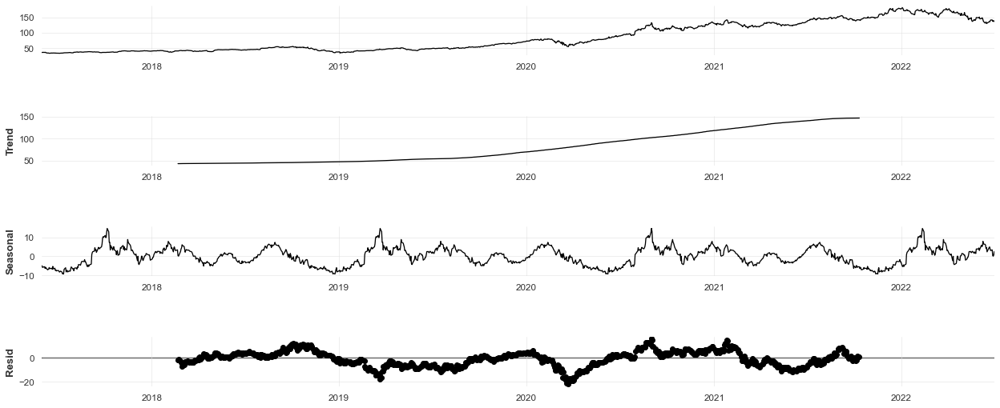

In [197]:
AAPL3_close = AAPL3[['Date', 'Adj_Close']].copy()
AAPL3_close = AAPL3_close.set_index('Date')
AAPL3_close.head()

decomp = seasonal_decompose(AAPL3_close, period=365)
fig = decomp.plot()
fig.set_size_inches(20, 8)

In [198]:
AAPL3['EMA_9'] = AAPL3['Adj_Close'].ewm(9).mean().shift()
AAPL3['SMA_5'] = AAPL3['Adj_Close'].rolling(5).mean().shift()
AAPL3['SMA_10'] = AAPL3['Adj_Close'].rolling(10).mean().shift()
AAPL3['SMA_15'] = AAPL3['Adj_Close'].rolling(15).mean().shift()
AAPL3['SMA_30'] = AAPL3['Adj_Close'].rolling(30).mean().shift()

fig = go.Figure()
fig.add_trace(go.Scatter(x=AAPL3.Date, y=AAPL3.EMA_9, name='EMA 9'))
fig.add_trace(go.Scatter(x=AAPL3.Date, y=AAPL3.SMA_5, name='SMA 5'))
fig.add_trace(go.Scatter(x=AAPL3.Date, y=AAPL3.SMA_10, name='SMA 10'))
fig.add_trace(go.Scatter(x=AAPL3.Date, y=AAPL3.SMA_15, name='SMA 15'))
fig.add_trace(go.Scatter(x=AAPL3.Date, y=AAPL3.SMA_30, name='SMA 30'))
fig.add_trace(go.Scatter(x=AAPL3.Date, y=AAPL3.Close, name='Adj_Close', opacity=0.2))
fig.show()

In [199]:
def relative_strength_idx(AAPL3, n=14):
    close = AAPL3['Adj_Close']
    delta = close.diff()
    delta = delta[1:]
    pricesUp = delta.copy()
    pricesDown = delta.copy()
    pricesUp[pricesUp < 0] = 0
    pricesDown[pricesDown > 0] = 0
    rollUp = pricesUp.rolling(n).mean()
    rollDown = pricesDown.abs().rolling(n).mean()
    rs = rollUp / rollDown
    rsi = 100.0 - (100.0 / (1.0 + rs))
    return rsi

AAPL3['RSI'] = relative_strength_idx(AAPL3).fillna(0)

fig = go.Figure(go.Scatter(x=AAPL3.Date, y=AAPL3.RSI, name='RSI'))
fig.show()

In [200]:
#MACD

EMA_12 = pd.Series(AAPL3['Adj_Close'].ewm(span=12, min_periods=12).mean())
EMA_26 = pd.Series(AAPL3['Adj_Close'].ewm(span=26, min_periods=26).mean())
AAPL3['MACD'] = pd.Series(EMA_12 - EMA_26)
AAPL3['MACD_signal'] = pd.Series(AAPL3.MACD.ewm(span=9, min_periods=9).mean())

fig = make_subplots(rows=2, cols=1)
fig.add_trace(go.Scatter(x=AAPL3.Date, y=AAPL3.Adj_Close, name='Adj_Close'), row=1, col=1)
fig.add_trace(go.Scatter(x=AAPL3.Date, y=EMA_12, name='EMA 12'), row=1, col=1)
fig.add_trace(go.Scatter(x=AAPL3.Date, y=EMA_26, name='EMA 26'), row=1, col=1)
fig.add_trace(go.Scatter(x=AAPL3.Date, y=AAPL3['MACD'], name='MACD'), row=2, col=1)
fig.add_trace(go.Scatter(x=AAPL3.Date, y=AAPL3['MACD_signal'], name='Signal line'), row=2, col=1)
fig.show()

In [201]:
AAPL3['Adj_Close'] = AAPL3['Adj_Close'].shift(-1)

In [202]:
AAPL3 = AAPL3.iloc[33:] # Because of moving averages and MACD line
AAPL3 = AAPL3[:-1]      # Because of shifting close price

AAPL3.index = range(len(AAPL3))

In [203]:
test_size  = 0.1
valid_size = 0.1

test_split_idx  = int(AAPL3.shape[0] * (1-test_size))
valid_split_idx = int(AAPL3.shape[0] * (1-(valid_size+test_size)))

train_df  = AAPL3.loc[:valid_split_idx].copy()
valid_df  = AAPL3.loc[valid_split_idx+1:test_split_idx].copy()
test_df   = AAPL3.loc[test_split_idx+1:].copy()

fig = go.Figure()
fig.add_trace(go.Scatter(x=train_df.Date, y=train_df.Adj_Close, name='Training'))
fig.add_trace(go.Scatter(x=valid_df.Date, y=valid_df.Adj_Close, name='Validation'))
fig.add_trace(go.Scatter(x=test_df.Date,  y=test_df.Adj_Close,  name='Test'))
fig.show()

In [204]:
drop_cols = ['Date', 'Volume', 'Open', 'Low', 'High','Close']

train_df = train_df.drop(drop_cols, 1)
valid_df = valid_df.drop(drop_cols, 1)
test_df  = test_df.drop(drop_cols, 1)

In [205]:
y_train = train_df['Adj_Close'].copy()
X_train = train_df.drop(['Adj_Close'], 1)

y_valid = valid_df['Adj_Close'].copy()
X_valid = valid_df.drop(['Adj_Close'], 1)

y_test  = test_df['Adj_Close'].copy()
X_test  = test_df.drop(['Adj_Close'], 1)

X_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 998 entries, 0 to 997
Data columns (total 8 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   EMA_9        998 non-null    float64
 1   SMA_5        998 non-null    float64
 2   SMA_10       998 non-null    float64
 3   SMA_15       998 non-null    float64
 4   SMA_30       998 non-null    float64
 5   RSI          998 non-null    float64
 6   MACD         998 non-null    float64
 7   MACD_signal  998 non-null    float64
dtypes: float64(8)
memory usage: 62.5 KB


In [206]:
%%time

parameters = {
    'n_estimators': [400, 500, 600],
    'learning_rate': [0.001, 0.01, 0.1],
    'max_depth': [8, 12, 15],
    'gamma': [0.001, 0.005, 0.01],
    'random_state': [42]
}

eval_set = [(X_train, y_train), (X_valid, y_valid)]
model = xgb.XGBRegressor(eval_set=eval_set, objective='reg:squarederror', verbose=False)
clf = GridSearchCV(model, parameters)

clf.fit(X_train, y_train)

print(f'Best params: {clf.best_params_}')
print(f'Best validation score = {clf.best_score_}')

[22:18:49] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:18:49] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:18:49] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:18:56] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:18:56] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:18:57] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:19:02] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:19:02] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:19:03] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:19:12] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:19:12] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:19:12] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:19:25] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:19:26] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:19:27] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:19:41] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:19:42] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:19:43] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:20:04] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:20:05] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:20:06] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:20:18] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:20:18] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:20:19] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:20:23] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:20:24] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:20:24] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:20:33] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:20:33] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:20:34] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:20:47] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:20:48] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:20:48] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:21:01] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:21:02] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:21:02] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:21:18] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:21:19] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:21:19] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:21:36] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:21:36] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:21:37] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:21:45] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:21:45] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:21:45] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:21:50] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:21:51] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:21:51] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:22:01] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:22:01] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:22:02] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:22:16] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:22:17] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:22:18] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:22:32] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:22:32] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:22:33] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:22:51] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:22:52] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:22:53] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

In [207]:
%%time

model = xgb.XGBRegressor(**clf.best_params_, objective='reg:squarederror')
model.fit(X_train, y_train, eval_set=eval_set, verbose=False)

Wall time: 913 ms


XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0.005, gpu_id=-1,
             importance_type='gain', interaction_constraints='',
             learning_rate=0.01, max_delta_step=0, max_depth=8,
             min_child_weight=1, missing=nan, monotone_constraints='()',
             n_estimators=600, n_jobs=16, num_parallel_tree=1, random_state=42,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=None)

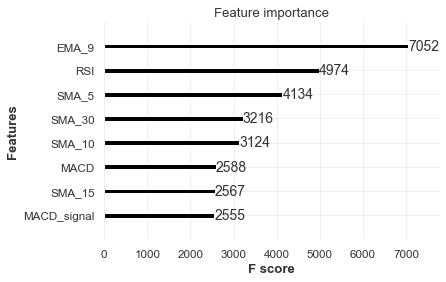

In [208]:
plot_importance(model);

In [209]:
y_pred = model.predict(X_test)
print(f'y_true = {np.array(y_test)[:5]}')
print(f'y_pred = {y_pred[:5]}')

y_true = [179.2080383 174.4411316 171.5291138 171.6986542 171.7185974]
y_pred = [129.68242 128.38007 124.34897 125.79321 128.94734]


In [210]:

print(f'mean_absolute_error = {mean_absolute_error(y_test, y_pred)}')

mean_absolute_error = 30.70842669285219


In [211]:
predicted_prices = AAPL3.loc[test_split_idx+1:].copy()
predicted_prices['Adj_Close'] = y_pred

fig = make_subplots(rows=2, cols=1)
fig.add_trace(go.Scatter(x=AAPL3.Date, y=AAPL3.Adj_Close,
                         name='Truth',
                         marker_color='LightSkyBlue'), row=1, col=1)

fig.add_trace(go.Scatter(x=predicted_prices.Date,
                         y=predicted_prices.Adj_Close,
                         name='Prediction',
                         marker_color='MediumPurple'), row=1, col=1)

fig.add_trace(go.Scatter(x=predicted_prices.Date,
                         y=y_test,
                         name='Truth',
                         marker_color='LightSkyBlue',
                         showlegend=False), row=2, col=1)

fig.add_trace(go.Scatter(x=predicted_prices.Date,
                         y=y_pred,
                         name='Prediction',
                         marker_color='MediumPurple',
                         showlegend=False), row=2, col=1)

fig.show()

## AMD Progression and Prediction

### Meta Prophet Prediction model


In [135]:
AMDfig = go.Figure()
AMDfig.add_trace(
    go.Scatter(
        x=AMD.Date,
        y=AMD.AMD,
        name='AMD Progression '
        
    
    )
)

In [136]:
AMD_pre = AMD.rename(columns={
    'Date': 'ds',
    'AMD': 'y'
})

AMD_pre

,ds,y
0,2017-06-01,10.930000
1,2017-06-02,10.900000
2,2017-06-05,11.240000
3,2017-06-06,12.030000
4,2017-06-07,12.380000
...,...,...
1276,2022-06-27,86.160004
1277,2022-06-28,80.779999
1278,2022-06-29,77.989998
1279,2022-06-30,76.470001


In [137]:
from prophet import Prophet
m = Prophet(
    yearly_seasonality=False,
    weekly_seasonality=False,
    daily_seasonality=True,
    seasonality_mode='additive'
    
)


m.fit(AMD_pre)
future =m.make_future_dataframe(periods = 30)

future.tail(30)

,ds
1281,2022-07-02
1282,2022-07-03
1283,2022-07-04
1284,2022-07-05
1285,2022-07-06
1286,2022-07-07
1287,2022-07-08
1288,2022-07-09
1289,2022-07-10
1290,2022-07-11


In [138]:
df_no_weekdays = future[future['ds'].dt.dayofweek < 5]
df_no_weekdays

,ds
0,2017-06-01
1,2017-06-02
2,2017-06-05
3,2017-06-06
4,2017-06-07
...,...
1304,2022-07-25
1305,2022-07-26
1306,2022-07-27
1307,2022-07-28


In [139]:
forecast1 = m.predict(future)

forecast1[['ds', 'yhat','yhat_lower', 'yhat_upper']].tail(30)

,ds,yhat,yhat_lower,yhat_upper
1281,2022-07-02,116.096225,102.462142,131.538485
1282,2022-07-03,116.138120,100.824764,129.839774
1283,2022-07-04,116.180015,101.832565,130.768394
1284,2022-07-05,116.221910,101.209029,129.798707
1285,2022-07-06,116.263806,101.855690,130.084804
1286,2022-07-07,116.305701,102.472020,130.781286
1287,2022-07-08,116.347596,101.655981,129.710611
1288,2022-07-09,116.389491,101.225941,130.723045
1289,2022-07-10,116.431387,101.848601,129.992652
1290,2022-07-11,116.473282,101.986027,131.598400


In [140]:
df_no_weekdays = forecast1[forecast1['ds'].dt.dayofweek < 5]
df_no_weekdays

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,daily_lower,daily_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2017-06-01,10.780324,-4.089593,24.532316,10.780324,10.780324,-0.545247,-0.545247,-0.545247,-0.545247,-0.545247,-0.545247,0.0,0.0,0.0,10.235077
1,2017-06-02,10.793156,-4.211108,23.910857,10.793156,10.793156,-0.545247,-0.545247,-0.545247,-0.545247,-0.545247,-0.545247,0.0,0.0,0.0,10.247909
2,2017-06-05,10.831649,-3.448595,25.239053,10.831649,10.831649,-0.545247,-0.545247,-0.545247,-0.545247,-0.545247,-0.545247,0.0,0.0,0.0,10.286403
3,2017-06-06,10.844481,-4.563520,23.033603,10.844481,10.844481,-0.545247,-0.545247,-0.545247,-0.545247,-0.545247,-0.545247,0.0,0.0,0.0,10.299234
4,2017-06-07,10.857312,-4.577937,24.097948,10.857312,10.857312,-0.545247,-0.545247,-0.545247,-0.545247,-0.545247,-0.545247,0.0,0.0,0.0,10.312065
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1304,2022-07-25,117.605062,103.248602,131.566637,117.586727,117.632778,-0.545247,-0.545247,-0.545247,-0.545247,-0.545247,-0.545247,0.0,0.0,0.0,117.059815
1305,2022-07-26,117.646957,102.442559,131.667404,117.622687,117.676947,-0.545247,-0.545247,-0.545247,-0.545247,-0.545247,-0.545247,0.0,0.0,0.0,117.101710
1306,2022-07-27,117.688852,103.239862,132.106576,117.662183,117.721196,-0.545247,-0.545247,-0.545247,-0.545247,-0.545247,-0.545247,0.0,0.0,0.0,117.143606
1307,2022-07-28,117.730748,103.591374,133.406638,117.700923,117.766301,-0.545247,-0.545247,-0.545247,-0.545247,-0.545247,-0.545247,0.0,0.0,0.0,117.185501


In [142]:
import plotly.offline as py
fig = plot_plotly(m, df_no_weekdays)
py.iplot(fig)

In [143]:
m1 = Prophet(
    changepoint_prior_scale=0.25, # increasing it will make the trend more flexible
    changepoint_range=0.97, # place potential changepoints in the first 98% of the time series
    yearly_seasonality=False,
    weekly_seasonality=False,
    daily_seasonality=True,
    seasonality_mode='multiplicative'
)

m1.fit(AMD_pre)

future1 = m1.make_future_dataframe(periods=30)
forecast1 = m1.predict(future1)
df_no_weekdays1 = forecast1[forecast1['ds'].dt.dayofweek < 5]
#forecast[['ds', 'yhat','yhat_lower', 'yhat_upper']].tail(20)
fig1 = plot_plotly(m1, df_no_weekdays1)
py.iplot(fig1)

### XGBRegression Prediction model

In [144]:
import os
import numpy as np
import pandas as pd
import xgboost as xgb
import matplotlib.pyplot as plt
from xgboost import plot_importance, plot_tree
from sklearn.metrics import mean_absolute_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split, GridSearchCV

# Time series decomposition
#!pip install stldecompose
from statsmodels.tsa.seasonal import seasonal_decompose

# Chart drawing
import plotly.offline as py
import plotly.io as pio
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

# Mute sklearn warnings
from warnings import simplefilter
simplefilter(action='ignore', category=FutureWarning)
simplefilter(action='ignore', category=DeprecationWarning)

# Show charts when running kernel
init_notebook_mode(connected=True)

# Change default background color for all visualizations
layout=go.Layout(paper_bgcolor='rgba(0,0,0,0)', plot_bgcolor='rgba(250,250,250,0.8)')
fig = go.Figure(layout=layout)
templated_fig = pio.to_templated(fig)
pio.templates['my_template'] = templated_fig.layout.template
pio.templates.default = 'my_template'

In [145]:
import pandas_datareader as web
#ticker = pd.read_csv('./nasdaq_techundtelelar77.csv')['Symbol']
AMD1 = pd.DataFrame
AMD1 = web.DataReader('AMD','yahoo', start= '2017-06-01',end= '2022-07-01')
                                                        
        
        
#AMD1.to_csv('AMD_hist_price.csv')

In [147]:
AMD1 = pd.read_csv('./ML_data/AMD_hist_price.csv')
AMD1

,Date,High,Low,Open,Close,Volume,Adj_Close
0,2017-06-01,11.290000,10.810000,11.250000,10.930000,48002000,10.930000
1,2017-06-02,10.960000,10.570000,10.930000,10.900000,43056200,10.900000
2,2017-06-05,11.340000,10.800000,10.840000,11.240000,66207300,11.240000
3,2017-06-06,12.240000,11.240000,11.270000,12.030000,114998600,12.030000
4,2017-06-07,12.960000,12.230000,12.420000,12.380000,151005900,12.380000
...,...,...,...,...,...,...,...
1276,2022-06-27,88.220001,85.250000,87.360001,86.160004,74663500,86.160004
1277,2022-06-28,86.730003,80.430000,85.709999,80.779999,95618600,80.779999
1278,2022-06-29,79.750000,76.510002,79.550003,77.989998,104140900,77.989998
1279,2022-06-30,78.910004,75.480003,77.730003,76.470001,105368600,76.470001


In [148]:
AMD1['Date'] = pd.to_datetime(AMD1['Date'])
AMD1 = AMD1[(AMD1['Date'].dt.year >= 2017)].copy()
AMD1.index = range(len(AMD1))

In [149]:
fig = make_subplots(rows=2, cols=1)

fig.add_trace(go.Ohlc(x=AMD1.Date,
                      open=AMD1.Open,
                      high=AMD1.High,
                      low=AMD1.Low,
                      close=AMD1.Adj_Close,
                      name='Price'), row=1, col=1)

fig.add_trace(go.Scatter(x=AMD1.Date, y=AMD1.Volume, name='Volume'), row=2, col=1)

fig.update(layout_xaxis_rangeslider_visible=False)
fig.show()

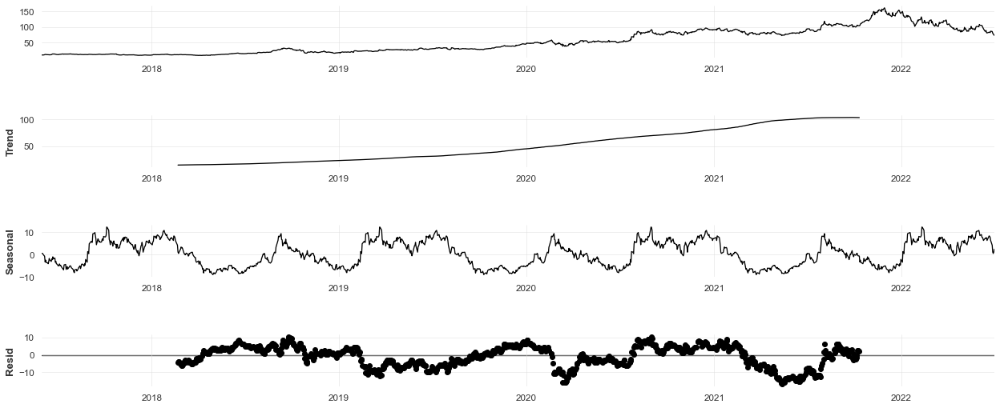

In [150]:
AMD1_close = AMD1[['Date', 'Adj_Close']].copy()
AMD1_close = AMD1_close.set_index('Date')
AMD1_close.head()

decomp = seasonal_decompose(AMD1_close, period=365)
fig = decomp.plot()
fig.set_size_inches(20, 8)

In [151]:
AMD1['EMA_9'] = AMD1['Adj_Close'].ewm(9).mean().shift()
AMD1['SMA_5'] = AMD1['Adj_Close'].rolling(5).mean().shift()
AMD1['SMA_10'] = AMD1['Adj_Close'].rolling(10).mean().shift()
AMD1['SMA_15'] = AMD1['Adj_Close'].rolling(15).mean().shift()
AMD1['SMA_30'] = AMD1['Adj_Close'].rolling(30).mean().shift()

fig = go.Figure()
fig.add_trace(go.Scatter(x=AMD1.Date, y=AMD1.EMA_9, name='EMA 9'))
fig.add_trace(go.Scatter(x=AMD1.Date, y=AMD1.SMA_5, name='SMA 5'))
fig.add_trace(go.Scatter(x=AMD1.Date, y=AMD1.SMA_10, name='SMA 10'))
fig.add_trace(go.Scatter(x=AMD1.Date, y=AMD1.SMA_15, name='SMA 15'))
fig.add_trace(go.Scatter(x=AMD1.Date, y=AMD1.SMA_30, name='SMA 30'))
fig.add_trace(go.Scatter(x=AMD1.Date, y=AMD1.Close, name='Adj_Close', opacity=0.2))
fig.show()

In [152]:
def relative_strength_idx(AMD1, n=14):
    close = AMD1['Adj_Close']
    delta = close.diff()
    delta = delta[1:]
    pricesUp = delta.copy()
    pricesDown = delta.copy()
    pricesUp[pricesUp < 0] = 0
    pricesDown[pricesDown > 0] = 0
    rollUp = pricesUp.rolling(n).mean()
    rollDown = pricesDown.abs().rolling(n).mean()
    rs = rollUp / rollDown
    rsi = 100.0 - (100.0 / (1.0 + rs))
    return rsi

AMD1['RSI'] = relative_strength_idx(AMD1).fillna(0)

fig = go.Figure(go.Scatter(x=AMD1.Date, y=AMD1.RSI, name='RSI'))
fig.show()

In [153]:
#MACD

EMA_12 = pd.Series(AMD1['Adj_Close'].ewm(span=12, min_periods=12).mean())
EMA_26 = pd.Series(AMD1['Adj_Close'].ewm(span=26, min_periods=26).mean())
AMD1['MACD'] = pd.Series(EMA_12 - EMA_26)
AMD1['MACD_signal'] = pd.Series(AMD1.MACD.ewm(span=9, min_periods=9).mean())

fig = make_subplots(rows=2, cols=1)
fig.add_trace(go.Scatter(x=AMD1.Date, y=AMD1.Adj_Close, name='Adj_Close'), row=1, col=1)
fig.add_trace(go.Scatter(x=AMD1.Date, y=EMA_12, name='EMA 12'), row=1, col=1)
fig.add_trace(go.Scatter(x=AMD1.Date, y=EMA_26, name='EMA 26'), row=1, col=1)
fig.add_trace(go.Scatter(x=AMD1.Date, y=AMD1['MACD'], name='MACD'), row=2, col=1)
fig.add_trace(go.Scatter(x=AMD1.Date, y=AMD1['MACD_signal'], name='Signal line'), row=2, col=1)
fig.show()

In [154]:
AMD1['Adj_Close'] = AMD1['Adj_Close'].shift(-1)
AMD1 = AMD1.iloc[33:] # Because of moving averages and MACD line
AMD1 = AMD1[:-1]      # Because of shifting close price

AMD1.index = range(len(AMD1))

In [155]:
test_size  = 0.1
valid_size = 0.1

test_split_idx  = int(AMD1.shape[0] * (1-test_size))
valid_split_idx = int(AMD1.shape[0] * (1-(valid_size+test_size)))

train_df  = AMD1.loc[:valid_split_idx].copy()
valid_df  = AMD1.loc[valid_split_idx+1:test_split_idx].copy()
test_df   = AMD1.loc[test_split_idx+1:].copy()

fig = go.Figure()
fig.add_trace(go.Scatter(x=train_df.Date, y=train_df.Adj_Close, name='Training'))
fig.add_trace(go.Scatter(x=valid_df.Date, y=valid_df.Adj_Close, name='Validation'))
fig.add_trace(go.Scatter(x=test_df.Date,  y=test_df.Adj_Close,  name='Test'))
fig.show()

In [103]:
drop_cols = ['Date', 'Volume', 'Open', 'Low', 'High','Close']

train_df = train_df.drop(drop_cols, 1)
valid_df = valid_df.drop(drop_cols, 1)
test_df  = test_df.drop(drop_cols, 1)

In [104]:
y_train = train_df['Adj_Close'].copy()
X_train = train_df.drop(['Adj_Close'], 1)

y_valid = valid_df['Adj_Close'].copy()
X_valid = valid_df.drop(['Adj_Close'], 1)

y_test  = test_df['Adj_Close'].copy()
X_test  = test_df.drop(['Adj_Close'], 1)

X_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 998 entries, 0 to 997
Data columns (total 8 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   EMA_9        998 non-null    float64
 1   SMA_5        998 non-null    float64
 2   SMA_10       998 non-null    float64
 3   SMA_15       998 non-null    float64
 4   SMA_30       998 non-null    float64
 5   RSI          998 non-null    float64
 6   MACD         998 non-null    float64
 7   MACD_signal  998 non-null    float64
dtypes: float64(8)
memory usage: 62.5 KB


In [105]:
%%time
from sklearn.model_selection import train_test_split, GridSearchCV,KFold
parameters = {
    'n_estimators': [200, 500, 600],
    'learning_rate': [0.001, 0.01, 0.1],
    'max_depth': [8, 12, 15],
    'gamma': [0.005, 0.01],
    'random_state': [42],
    'subsample':[0.8,1],
    'colsample_bytree':[1],
    'colsample_bylevel':[1]
}
kfold = KFold(5)
eval_set = [(X_train, y_train), (X_valid, y_valid)]
model = xgb.XGBRegressor(eval_set=eval_set, objective='reg:squarederror',n_jobs=-1, verbose=False)
clf = GridSearchCV(model, parameters, cv= kfold,scoring='neg_mean_absolute_error',verbose=0)

clf.fit(X_train, y_train)

print(f'Best params: {clf.best_params_}')
print(f'Best validation score = {clf.best_score_}')

[20:56:15] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:56:16] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:56:16] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[20:56:20] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:56:20] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:56:21] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[20:56:25] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:56:25] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:56:26] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[20:56:32] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:56:32] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:56:32] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[20:56:37] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:56:38] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:56:38] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[20:56:44] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:56:45] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:56:45] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[20:56:56] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:56:56] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:56:56] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[20:57:14] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:57:16] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:57:16] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[20:57:27] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:57:28] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:57:30] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[20:57:45] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:57:45] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:57:46] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[20:57:58] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:57:59] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:57:59] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[20:58:15] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:58:16] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:58:17] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[20:58:33] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:58:34] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:58:36] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[20:58:59] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:58:59] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:59:00] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[20:59:06] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:59:06] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:59:06] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[20:59:11] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:59:11] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:59:11] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[20:59:19] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:59:19] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:59:19] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[20:59:26] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:59:26] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:59:27] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[20:59:34] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:59:35] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:59:36] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[20:59:45] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:59:45] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[20:59:46] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[21:00:05] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[21:00:05] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[21:00:05] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[21:00:19] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[21:00:20] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[21:00:21] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[21:00:34] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[21:00:34] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[21:00:35] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[21:00:46] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[21:00:46] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[21:00:47] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[21:01:05] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[21:01:06] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[21:01:07] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[21:01:24] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[21:01:25] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[21:01:26] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

In [106]:
%%time

model = xgb.XGBRegressor(**clf.best_params_, objective='reg:squarederror')
model.fit(X_train, y_train, eval_set=eval_set, verbose=False)

Wall time: 675 ms


XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0.005, gpu_id=-1,
             importance_type='gain', interaction_constraints='',
             learning_rate=0.1, max_delta_step=0, max_depth=15,
             min_child_weight=1, missing=nan, monotone_constraints='()',
             n_estimators=200, n_jobs=16, num_parallel_tree=1, random_state=42,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=None)

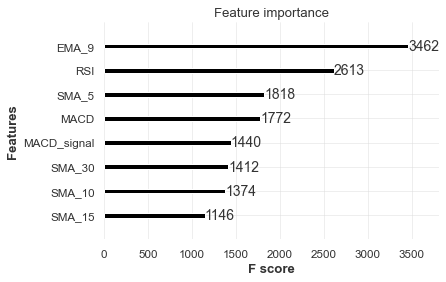

In [107]:
plot_importance(model);

In [108]:
y_pred = model.predict(X_test)
print(f'y_true = {np.array(y_test)[:5]}')
print(f'y_pred = {y_pred[:5]}')

y_true = [144.4199982 136.1499939 136.2299957 132.        132.       ]
y_pred = [90.434265 90.434265 88.324875 87.65243  87.868866]


In [109]:
from sklearn.metrics import mean_absolute_error
print(f'mean_absolute_error = {mean_absolute_error(y_test, y_pred)}')

mean_absolute_error = 18.89544191684397


In [110]:
predicted_prices = AMD1.loc[test_split_idx+1:].copy()
predicted_prices['Adj_Close'] = y_pred

fig = make_subplots(rows=2, cols=1)
fig.add_trace(go.Scatter(x=AMD1.Date, y=AMD1.Adj_Close,
                         name='Truth',
                         marker_color='LightSkyBlue'), row=1, col=1)

fig.add_trace(go.Scatter(x=predicted_prices.Date,
                         y=predicted_prices.Adj_Close,
                         name='Prediction',
                         marker_color='MediumPurple'), row=1, col=1)

fig.add_trace(go.Scatter(x=predicted_prices.Date,
                         y=y_test,
                         name='Truth',
                         marker_color='LightSkyBlue',
                         showlegend=False), row=2, col=1)

fig.add_trace(go.Scatter(x=predicted_prices.Date,
                         y=y_pred,
                         name='Prediction',
                         marker_color='MediumPurple',
                         showlegend=False), row=2, col=1)

fig.show()

## MSFT Progression and Prediction

### Prophet Model

In [159]:
MSFT_pre = MSFT.rename(columns={
    'Date': 'ds',
    'MSFT': 'y'
})

MSFT_pre

,ds,y
0,2017-06-01,65.659447
1,2017-06-02,67.214272
2,2017-06-05,67.701340
3,2017-06-06,67.926140
4,2017-06-07,67.804382
...,...,...
1276,2022-06-27,264.890015
1277,2022-06-28,256.480011
1278,2022-06-29,260.260010
1279,2022-06-30,256.829987


In [161]:
m1 = Prophet(
    changepoint_prior_scale=0.25, # increasing it will make the trend more flexible
    changepoint_range=0.97, # place potential changepoints in the first 98% of the time series
    yearly_seasonality=False,
    weekly_seasonality=False,
    daily_seasonality=True,
    seasonality_mode='multiplicative'
)

m1.fit(MSFT_pre)

future1 = m1.make_future_dataframe(periods=30)
forecast1 = m1.predict(future1)
df_no_weekdays1 = forecast1[forecast1['ds'].dt.dayofweek < 5]
#forecast[['ds', 'yhat','yhat_lower', 'yhat_upper']].tail(20)
fig1 = plot_plotly(m1, df_no_weekdays1)
py.iplot(fig1)

### LGBM Prediction model

In [168]:
import os
import numpy as np
import pandas as pd
import xgboost as xgb
import matplotlib.pyplot as plt
from xgboost import plot_importance, plot_tree
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split, GridSearchCV

# Time series decomposition
#!pip install stldecompose
from statsmodels.tsa.seasonal import seasonal_decompose

# Chart drawing
import plotly as py
import plotly.io as pio
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

# Mute sklearn warnings
from warnings import simplefilter
simplefilter(action='ignore', category=FutureWarning)
simplefilter(action='ignore', category=DeprecationWarning)

# Show charts when running kernel
init_notebook_mode(connected=True)

# Change default background color for all visualizations
layout=go.Layout(paper_bgcolor='rgba(0,0,0,0)', plot_bgcolor='rgba(250,250,250,0.8)')
fig = go.Figure(layout=layout)
templated_fig = pio.to_templated(fig)
pio.templates['my_template'] = templated_fig.layout.template
pio.templates.default = 'my_template'

In [169]:
import pandas_datareader as web
#ticker = pd.read_csv('./nasdaq_techundtelelar77.csv')['Symbol']
MSFT = pd.DataFrame
MSFT = web.DataReader('MSFT','yahoo', start= '2017-06-01',end= '2022-07-01')
                                                        
        
        
#MSFT.to_csv('./ML_data/MSFT_hist_price.csv')

In [170]:
MSFT = pd.read_csv('./ML_data/MSFT_hist_price.csv')
MSFT

,Date,High,Low,Open,Close,Volume,Adj_Close
0,2017-06-01,70.610001,69.449997,70.239998,70.099998,21603600,65.659439
1,2017-06-02,71.860001,70.239998,70.440002,71.760002,34770300,67.214294
2,2017-06-05,72.889999,71.809998,71.970001,72.279999,33316800,67.701355
3,2017-06-06,72.620003,72.269997,72.300003,72.519997,31511100,67.926147
4,2017-06-07,72.769997,71.949997,72.639999,72.389999,22301800,67.804390
...,...,...,...,...,...,...,...
1276,2022-06-27,268.299988,263.279999,268.209992,264.890015,24615100,264.890015
1277,2022-06-28,266.910004,256.320007,263.980011,256.480011,27295500,256.480011
1278,2022-06-29,261.970001,255.759995,257.589996,260.260010,20069800,260.260010
1279,2022-06-30,259.529999,252.899994,257.049988,256.829987,31730900,256.829987


In [171]:
MSFT['Date'] = pd.to_datetime(MSFT['Date'])
MSFT = MSFT[(MSFT['Date'].dt.year >= 2017)].copy()
MSFT.index = range(len(MSFT))

In [172]:
fig = make_subplots(rows=2, cols=1)

fig.add_trace(go.Ohlc(x=MSFT.Date,
                      open=MSFT.Open,
                      high=MSFT.High,
                      low=MSFT.Low,
                      close=MSFT.Adj_Close,
                      name='Price'), row=1, col=1)

fig.add_trace(go.Scatter(x=MSFT.Date, y=MSFT.Volume, name='Volume'), row=2, col=1)

fig.update(layout_xaxis_rangeslider_visible=False)
fig.show()

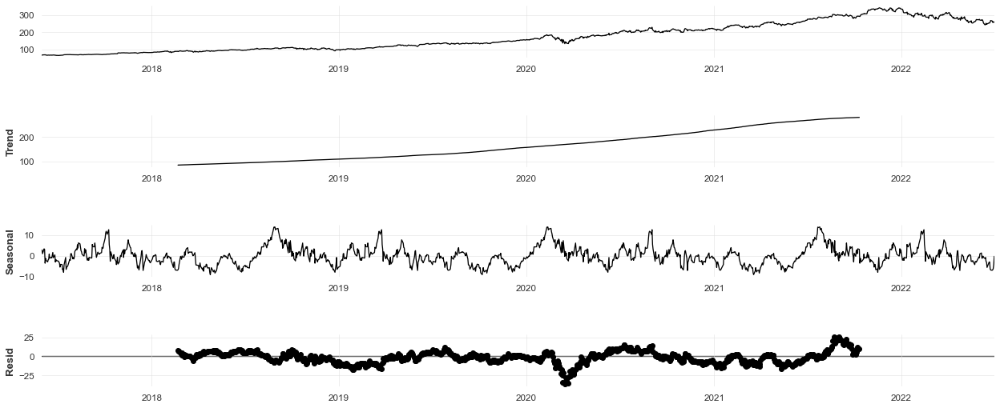

In [173]:
MSFT_close = MSFT[['Date', 'Adj_Close']].copy()
MSFT_close = MSFT_close.set_index('Date')
MSFT_close.head()

decomp = seasonal_decompose(MSFT_close, period=365)
fig = decomp.plot()
fig.set_size_inches(20, 8)

In [174]:
def relative_strength_idx(MSFT, n=14):
    close = MSFT['Adj_Close']
    delta = close.diff()
    delta = delta[1:]
    pricesUp = delta.copy()
    pricesDown = delta.copy()
    pricesUp[pricesUp < 0] = 0
    pricesDown[pricesDown > 0] = 0
    rollUp = pricesUp.rolling(n).mean()
    rollDown = pricesDown.abs().rolling(n).mean()
    rs = rollUp / rollDown
    rsi = 100.0 - (100.0 / (1.0 + rs))
    return rsi

MSFT['RSI'] = relative_strength_idx(AMD1).fillna(0)

fig = go.Figure(go.Scatter(x=MSFT.Date, y=MSFT.RSI, name='RSI'))
fig.show()

In [175]:
#MACD

EMA_12 = pd.Series(MSFT['Adj_Close'].ewm(span=12, min_periods=12).mean())
EMA_26 = pd.Series(MSFT['Adj_Close'].ewm(span=26, min_periods=26).mean())
MSFT['MACD'] = pd.Series(EMA_12 - EMA_26)
MSFT['MACD_signal'] = pd.Series(MSFT.MACD.ewm(span=9, min_periods=9).mean())

fig = make_subplots(rows=2, cols=1)
fig.add_trace(go.Scatter(x=MSFT.Date, y=MSFT.Adj_Close, name='Adj_Close'), row=1, col=1)
fig.add_trace(go.Scatter(x=MSFT.Date, y=EMA_12, name='EMA 12'), row=1, col=1)
fig.add_trace(go.Scatter(x=MSFT.Date, y=EMA_26, name='EMA 26'), row=1, col=1)
fig.add_trace(go.Scatter(x=MSFT.Date, y=MSFT['MACD'], name='MACD'), row=2, col=1)
fig.add_trace(go.Scatter(x=MSFT.Date, y=MSFT['MACD_signal'], name='Signal line'), row=2, col=1)
fig.show()

In [176]:
MSFT['Adj_Close'] = MSFT['Adj_Close'].shift(-1)
MSFT = MSFT.iloc[33:] # Because of moving averages and MACD line
MSFT = MSFT[:-1]      # Because of shifting close price

MSFT.index = range(len(MSFT))

In [177]:
test_size  = 0.1
valid_size = 0.1

test_split_idx  = int(MSFT.shape[0] * (1-test_size))
valid_split_idx = int(MSFT.shape[0] * (1-(valid_size+test_size)))

train_df  = MSFT.loc[:valid_split_idx].copy()
valid_df  = MSFT.loc[valid_split_idx+1:test_split_idx].copy()
test_df   = MSFT.loc[test_split_idx+1:].copy()

fig = go.Figure()
fig.add_trace(go.Scatter(x=train_df.Date, y=train_df.Adj_Close, name='Training'))
fig.add_trace(go.Scatter(x=valid_df.Date, y=valid_df.Adj_Close, name='Validation'))
fig.add_trace(go.Scatter(x=test_df.Date,  y=test_df.Adj_Close,  name='Test'))
fig.show()

In [178]:
drop_cols = ['Date', 'Volume', 'Open', 'Low', 'High','Close']

train_df = train_df.drop(drop_cols, 1)
valid_df = valid_df.drop(drop_cols, 1)
test_df  = test_df.drop(drop_cols, 1)

In [179]:
y_train = train_df['Adj_Close'].copy()
X_train = train_df.drop(['Adj_Close'], 1)

y_valid = valid_df['Adj_Close'].copy()
X_valid = valid_df.drop(['Adj_Close'], 1)

y_test  = test_df['Adj_Close'].copy()
X_test  = test_df.drop(['Adj_Close'], 1)

X_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 998 entries, 0 to 997
Data columns (total 3 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   RSI          998 non-null    float64
 1   MACD         998 non-null    float64
 2   MACD_signal  998 non-null    float64
dtypes: float64(3)
memory usage: 23.5 KB


In [186]:
%%time
from sklearn.model_selection import train_test_split, GridSearchCV,KFold
parameters = {
    'n_estimators': [600, 700, 800],
    'learning_rate': [0.001,0.01, 0.1],
    'max_depth': [8, 10, 12, 15],
    'gamma': [0.005, 0.01],
    'random_state': [42],
    'subsample':[0.8,1],
    'colsample_bytree':[1],
    'colsample_bylevel':[1]
}
kfold = KFold(5)
eval_set = [(X_train, y_train), (X_valid, y_valid)]
model = xgb.XGBRegressor(eval_set=eval_set, objective='reg:squarederror',n_jobs=-1, verbose=False)
clf = GridSearchCV(model, parameters, cv= kfold,scoring='neg_mean_absolute_error',verbose=0)

clf.fit(X_train, y_train)

print(f'Best params: {clf.best_params_}')
print(f'Best validation score = {clf.best_score_}')

[22:05:09] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:05:09] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:05:10] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:05:20] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:05:20] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:05:21] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:05:34] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:05:34] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:05:35] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:05:51] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:05:51] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:05:52] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:06:07] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:06:08] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:06:09] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:06:23] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:06:24] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:06:25] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:06:40] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:06:41] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:06:42] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:07:00] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:07:02] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:07:03] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:07:23] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:07:24] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:07:26] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:07:51] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:07:52] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:07:54] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:08:28] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:08:30] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:08:32] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:09:10] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:09:13] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:09:15] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:09:42] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:09:43] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:09:43] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:10:01] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:10:02] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:10:03] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:10:24] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:10:25] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:10:26] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:10:49] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:10:50] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:10:52] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:11:19] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:11:20] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:11:21] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:11:55] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:11:57] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:11:58] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:12:09] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:12:10] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:12:10] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:12:22] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:12:23] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:12:23] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:12:37] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:12:37] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:12:38] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:12:51] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:12:52] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:12:53] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:13:09] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:13:09] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:13:10] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:13:26] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:13:27] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:13:28] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:13:43] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:13:44] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:13:45] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:14:05] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:14:06] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:14:07] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:14:33] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:14:34] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:14:36] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:15:06] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:15:08] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:15:10] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:15:45] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:15:47] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:15:49] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:16:20] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:16:21] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:16:22] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:16:40] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:16:41] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:16:42] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:17:02] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:17:03] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:17:04] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:17:27] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:17:28] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:17:30] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:17:57] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:17:59] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:18:01] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

[22:18:34] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:18:36] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[22:18:37] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "eval_set", "verbose" } might not be used.

  This may not be accurate due to some par

In [187]:
%%time

model = xgb.XGBRegressor(**clf.best_params_, objective='reg:squarederror')
model.fit(X_train, y_train, eval_set=eval_set, verbose=False)

Wall time: 877 ms


XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0.005, gpu_id=-1,
             importance_type='gain', interaction_constraints='',
             learning_rate=0.01, max_delta_step=0, max_depth=8,
             min_child_weight=1, missing=nan, monotone_constraints='()',
             n_estimators=600, n_jobs=16, num_parallel_tree=1, random_state=42,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=0.8,
             tree_method='exact', validate_parameters=1, verbosity=None)

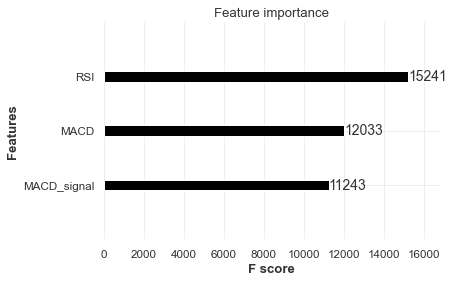

In [188]:
plot_importance(model);

In [189]:
y_pred = model.predict(X_test)
print(f'y_true = {np.array(y_test)[:5]}')
print(f'y_pred = {y_pred[:5]}')

y_true = [327.5681763 314.9935303 312.5044861 312.6637878 312.8927612]
y_pred = [135.07489 112.8897  208.67143 194.10872 207.30298]


In [190]:
print(f'mean_absolute_error = {mean_absolute_error(y_test, y_pred)}')

mean_absolute_error = 135.96885650593265


In [191]:
predicted_prices = MSFT.loc[test_split_idx+1:].copy()
predicted_prices['Adj_Close'] = y_pred

fig = make_subplots(rows=2, cols=1)
fig.add_trace(go.Scatter(x=MSFT.Date, y=MSFT.Adj_Close,
                         name='Truth',
                         marker_color='LightSkyBlue'), row=1, col=1)

fig.add_trace(go.Scatter(x=predicted_prices.Date,
                         y=predicted_prices.Adj_Close,
                         name='Prediction',
                         marker_color='MediumPurple'), row=1, col=1)

fig.add_trace(go.Scatter(x=predicted_prices.Date,
                         y=y_test,
                         name='Truth',
                         marker_color='LightSkyBlue',
                         showlegend=False), row=2, col=1)

fig.add_trace(go.Scatter(x=predicted_prices.Date,
                         y=y_pred,
                         name='Prediction',
                         marker_color='MediumPurple',
                         showlegend=False), row=2, col=1)

fig.show()